In [1]:
import matplotlib.pyplot as plt
from IPython.display import display, Math, Image

# if using a jupyter notebook: include %matplotlib inline. If constructing a .py-file: comment out
%matplotlib inline
# if high-resolution images are desired: include %config InlineBackend.figure_format = 'svg'
%config InlineBackend.figure_format = 'svg'
import schemdraw
import schemdraw.elements as elm
import sympy as sp
import numpy as np
import scipy.signal as sig
from splane import analyze_sys
import matplotlib as mpl
from splane import *


$$\require{cancel}$$       

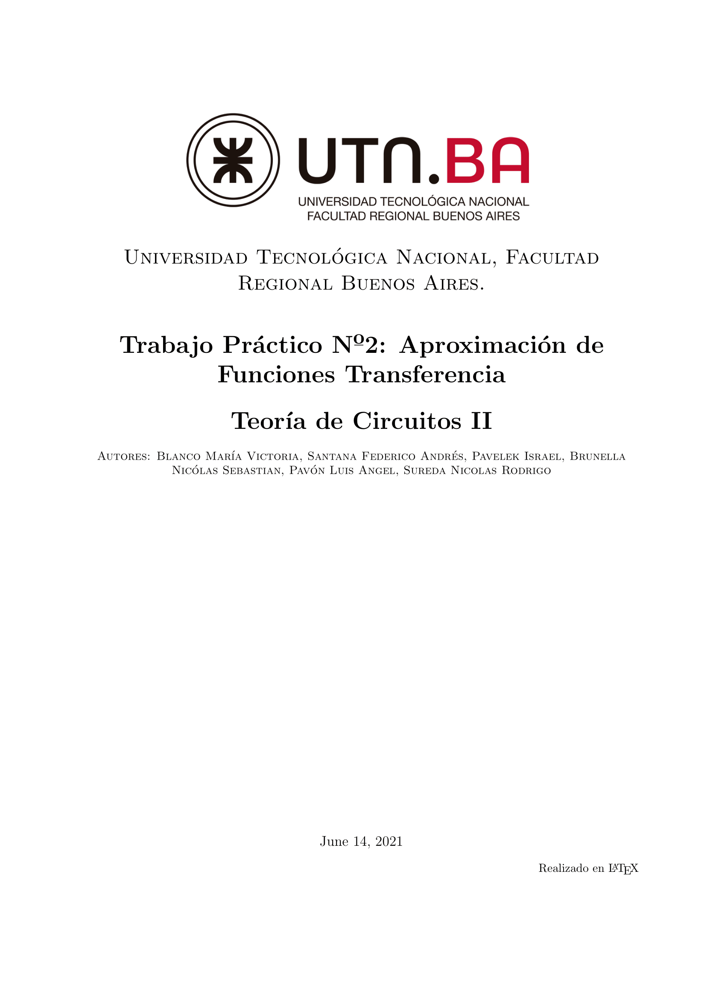

In [2]:
Image(filename='imagenes/Portada.png') 

## Ejercicio 1

El siguiente filtro pasabajos debe presentar una respuesta Butterworth con un ancho de banda de -3dB a 1KHz. Determinar el valor de L y C sabiendo que la carga es de 1 KΩ. Verificar las especificaciones del filtro mediante el uso de simuladores. Sugerencia: diseñar el filtro con valores normalizados en frecuencia e impedancia y luego desnormalizar para calcular el valor del filtro pedido

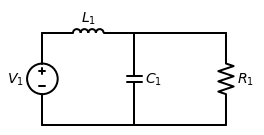

In [3]:

d = schemdraw.Drawing()
L1 = d.add(elm.Inductor().label('$L_1$'))
C1 = d.add(elm.Capacitor().down().label('$C_1$', loc='bottom'))
d += elm.Line().right()
R1 = d.add(elm.Resistor().up().label('$R_1$', loc='bottom'))
d.add(elm.Line().left())
line = d.add(elm.Line().left().at(C1.end))
V1 = d.add(elm.elm.SourceV().up().label('$V_1$',loc='top'))




d.draw()

Primero calcularemos la transferencia de este filtro, que es $$H(s)=\frac{z_1}{z_1+z_2}=\frac{\frac{z_c\cdot z_r}{z_c+z_r}}{z_l+\frac{z_c\cdot z_r}{z_c+z_r}}$$

In [4]:
# Definimos las variables y funciones
C,R,L = sp.symbols('C R L', positive=True)
s = sp.symbols('s')
H = sp.symbols('H', cls=sp.Function)

Z_c = 1/(s*C)
Z_l = s*L
Z_r = R

Z_2 = sp.simplify((Z_r * Z_c) / (Z_r + Z_c))

dem = sp.factor(Z_l + Z_2)

H = sp.factor(Z_2/(Z_l+Z_2))
display(Math("H(s)="+sp.latex(H)))

<IPython.core.display.Math object>

Lo queremos en su forma mónica, planeaba usar el comando $sympy.monic$ de $sympy.poly$

In [5]:
numerador, denominador = sp.fraction(H)
num = numerador / sp.poly(denominador,s).LC()
dem = sp.monic(sp.poly(denominador, s))
H = sp.Mul(num , 1/dem, evaluate=False)
display(Math("H(s)="+sp.latex(H)))


<IPython.core.display.Math object>

Nos interesa que sea un Butterworth de segundo orden, una transferencia de butterworth de segundo orden es:

$$H(s)=\frac{w_0}{s^2+\frac{w_0}{Q}s+w_0}$$

Normalizado a $$w_0 = 1$$

$$H(s)=\frac{1}{s^2+\sqrt{2}s+1}$$


De ahí deducimos que: 

$$\sqrt{2}=\frac{1}{CR} , L = \frac{1}{C}$$

R puede tener cualquier valor porque tengo un grado de libertad, decido $R=1\Omega$
$$C = \frac{1}{\sqrt{2}} \approx 0.707F$$
$$L = \frac{1}{C} \approx 1.414Hy$$

Simulación:

Captura de la simulación acá

## Ejercicio 2

Se desea diseñar un filtro pasabajos con las siguientes características.
- Máxima planicidad en la banda de paso
- Máxima atenuación: $0.02 dB$ para $0 < ⍵ < 1$
- Mínima atenuación para $⍵ > 2.2: 48 dB$
Se pide obtener los parámetros $n$ y $ɛ$


Sabemos que:

$$w_p = 1$$
$$w_s = 2.2$$
$$\alpha_{max}=0.02dB$$
$$\alpha_{min}=48dB$$

$$\epsilon = \sqrt{10^{-0.1\alpha_{max}} - 1}$$
$$\epsilon = \sqrt{10^{-0.1\cdot0.02dB} - 1}$$
$$\epsilon \approx 0.068$$

Además N:

$$N=\frac{log\left(\frac{10^{0.1\alpha_{min}}-1}{\epsilon^2}\right)}{2\cdot \log(w_s)}\approx 10.41 \Longrightarrow N=11$$

## Ejercicio 3
![](Ej3.png)

Aprovechando que todos tienen la misma $f_p$, normalizamos a esa frecuencia pero para poder trabajar cómodamente en $\omega$ lo hacemos por 2pi, es decir:

$$\Omega_w=2\pi \cdot f_p = 2\pi \cdot 1KHz$$

Calculamos \epsilon y N para cada caso

In [6]:
ripple = [0.5, 0.5 ,1.0 ,0.5] # dB \alpha_{max} 
attenuation = [30,20,35,20] # dB \alpha_{min} 
ws=[2.33 , 2.0 , 3.5 , 1.725]
  
eps = np.sqrt(np.subtract(np.power(10,np.divide(ripple,10)),1)).round(2)
orders =  np.divide(np.log10(np.divide(np.subtract(np.power(10,np.divide(attenuation,10)),1),np.power(eps,2))),(np.multiply(2,np.log10(ws))))
orders=np.ceil(orders)
eps=np.round(eps,2)
filtro=1
for (this_order, this_eps) in zip(orders,eps):
    
    display(f'El filtro Nº {filtro} es de orden: {this_order} con ε: {this_eps}')
    filtro=filtro+1


'El filtro Nº 1 es de orden: 6.0 con ε: 0.35'

'El filtro Nº 2 es de orden: 5.0 con ε: 0.35'

'El filtro Nº 3 es de orden: 4.0 con ε: 0.51'

'El filtro Nº 4 es de orden: 7.0 con ε: 0.35'


<table width="500" height="362" border="1">
  <tr>
    <td>Circuito</td>
    <td> $\alpha_{max}$ </td>
    <td>$\alpha_{min} $</td>
    <td>fp</td>
    <td>fs</td>
    <td>$\epsilon $</td>
    <td>N</td>
  </tr>
  <tr>
    <td>1</td>
    <td>0,5</td>
    <td>30</td>
    <td>1</td>
    <td>2,33</td>
    <td>0,35</td>
    <td>6</td>
  </tr>
  <tr>
    <td>2</td>
    <td>0,5</td>
    <td>20</td>
    <td>1</td>
    <td>2,0</td>
    <td>0,35</td>
    <td>5</td>
  </tr>
  <tr>
    <td>3</td>
    <td>1</td>
    <td>35</td>
    <td>1</td>
    <td>3,5</td>
    <td>0,51</td>
    <td>4</td>
  </tr>
  <tr>
    <td>4</td>
    <td>0,5</td>
    <td>20</td>
    <td>1</td>
    <td>1,725</td>
    <td>0,35</td>
    <td>7</td>
  </tr>
</table>

### Circuito 1:

#### Polos:

Tiene 6 polos cada $ 180º/6 =30 $

Como es de orden Par no posee polos sobre el eje $\sigma$

Posee 3 pares de polos complejos conjugados

Los ángulos de los polos se encuentran en:

$$ \theta_1 = 180º- \frac{30º}{2}= 165º \ \ \ Polo \ de \ menor\ Q $$
$$ \theta_2 = 180º- \frac{30º}{2}-30º= 135º $$
$$ \theta_3 = 180º- \frac{30º}{2}-30º-30º= 105º \ \ \ Polo \ de \ mayor \ Q \ (Más\ cerca \ del \ eje \ j\omega) $$

Obtención de los polos:

$P_n=\alpha_n \pm j\beta_n$

$\alpha_n = \omega_n \cdot cos(\theta_n) $

$\beta_n = \omega_n \cdot sen(\theta_n) $

La configuracióin de polos y ceros no cambia si está normalizado para $\omega_n = 1 \frac{rad}{seg} $ 
<br>Luego vamos a poder escalar el diagrama (porque lo que cambia es el modulo de la úbicación de los polos

$\alpha_1= cos(165º)=-0,96$

$\alpha_2= cos(135º)=-\frac{\sqrt{2}}{2}$

$\alpha_3= cos(105º)=-0,26$

$\beta_1 = sen(165º)=0,25$

$\beta_2 = sen(135º)=\frac{\sqrt{2}}{2}$

$\beta_3 = sen(105º)=0,96$

$$P_{1,2}=-0,96\pm j0,25  $$

$$P_{3,4}=-\frac{\sqrt{2}}{2}\pm j-\frac{\sqrt{2}}{2}  $$

$$P_{5,6}=-0,25\pm j0,96  $$

Como la Normalización provoca una contracción del diagrama de polos y ceros expandimos

$Polo \ Real = \omega_{norm} \cdot Polo_{nomr} $

Como no es butter puro desnormalizamos para $\omega_{B}=\epsilon^{\frac{-1}{N}} \cdot \omega_{norm}$

$\omega_{B}=\epsilon^{\frac{-1}{N}}= 0,35^{\frac{-1}{6}} \cdot {2\pi1KHz}=7477 \frac{rad}{seg}$

$$P_{1,2}=-0,96\pm j0,25 \ \Longrightarrow  P_1=8523,77\pm j1869,25 $$

$$P_{3,4}=-\frac{\sqrt{2}}{2}\pm j-\frac{\sqrt{2}}{2}  \Longrightarrow  P_2=5287,03\pm j5287,03 $$

$$P_{5,6}=-0,25\pm j0,96  \Longrightarrow  P_3=1869,25\pm j8523,77 $$

De ahora en más ya que no cambia expondremos los resultados de los polos normalizados, la desnormalización la dejaremos para la etapa de la implemetnación circuital.

#### Obtención del Q de cada etapa:

$$ Q= \frac{1}{2 \cdot cos(180º-\theta)} $$

$$cos(180º-\theta)=-cos(\theta)$$

$$ Q_{1,2}= \frac{1}{2 \cdot -cos(165)}= 0,517 $$

$$ Q_{3,4}= \frac{1}{2 \cdot -cos(135º)}= 0,707$$

$$ Q_{4,5}= \frac{1}{2 \cdot -cos(105º)}= 1,93$$

#### Implementación con estructura Sallen-Key

Recordamos la estructura Sallen-Key de un filtro Pasa_Bajo:

<img src="imagenes/Sallen-Key.png" align="center" width="400" /> 

Con sus ecuaciones de diseño:

$$K=1+\frac{Rb}{Ra}$$

$$Q=\frac{\sqrt{C_1C_2}}{2C_2+C_1(1-K)}$$

$$\omega_c=\frac{1}{R\sqrt{C_1C_2}} $$

En donde: 

Como necesito ganar 20dB en la banda de paso 

G=10 veces

Cada etapa puede ganar como minimo 2

Coloco 2 que ganan 2 y una que gane 2,5 

Podría tambien haber elegido que todas ganen 2,15 pero es más sencillo de lograr la ganancia de 2 con resistores iguales, y dado que este circuito el Q es sensible de K, prefiero dejar de forma fija 2 celdas al menos.

Para las etapas de ganancia 2:

$Rb=Ra$

$$Q=\frac{\sqrt{C_1C_2}}{2C_2-C_1}$$

$$\omega_c=\frac{1}{R\sqrt{C_1C_2}} $$

Si adopto:

$$C_1= C \ \ y \\ C_2=nC_1 \ \  y  \ \ R=1 $$

De la expresión de la frecuencia (como està normalizado)

$$1=\frac{1}{R\sqrt{C_1C_2}} $$

$$1=\frac{1}{C\sqrt{n}} $$

$$C=\frac{1}{\sqrt{n}} $$

$$C_1=C $$

$$C_2=C_1 \cdot n $$

$$C_2=\cancel{C} \cdot \frac{1}{C^\cancel{2}}$$

$$C_2= \frac{1}{C} $$


De la expresión del Q reemplazando

$$Q=\frac{\cancel{C}\sqrt{n}}{\cancel{C}(2n-1)}$$

$$Q=\frac{\sqrt{n}}{(2n-1)}$$

$$Q=\frac{1}{C(2\frac{1}{C^2}-1)}$$

$$Q=\frac{C^\cancel{2}}{\cancel{C}(2-C^2)}$$

$$Q=\frac{C}{(2-C^2)}$$

$$2Q-QC^2=C$$

$$C^2+\frac{C}{Q}-2=0$$

Para la primer etapa Q=0,517

$C=0,746F=C1$

$C_2=\frac{1}{C}=1,34,$

Verificando en la ecuación de transferencia de Sallen-Key:

$$\frac{Vo}{V1}=\frac{K}{S^2(R^2C_1C_2)+S(RC_2+RC_2+RC_1(1-K))+1}$$

Si R=1 C1=0,746 y C2=1,34 y K=2

$$\frac{Vo}{V1}=\frac{2}{S^2+S(2\cdot1,34-0,746)+1}$$

$$\frac{Vo}{V1}=\frac{2}{S^2+S(1,934)+1}$$

$$Q=\frac{1}{1,934}=0,517 $$

$$ \omega_n=1\frac{rad}{seg} $$

$$K=2 $$


Para las segunda etapa utilzamos las mismas expresiones:

$C^2+\frac{C}{Q}-2=0$

Para la segunda etapa Q=0,707

$C=0,87F=C1$

$C_2=\frac{1}{C}=1,15$

Para la tercer etapa modificamos porque ahora K= 2.5 y Q=1,93

$$Q=\frac{\cancel{C}\sqrt{n}}{\cancel{C}(2n-1,5)}$$

$$Q=\frac{\sqrt{n}}{(2n-1,5)}$$

$$Q=\frac{1}{C(2\frac{1}{C^2}-1,5)}$$

$$Q=\frac{C^\cancel{2}}{\cancel{C}(2-1,5C^2)}$$

$$Q=\frac{C}{(2-1,5C^2)}$$

$$2Q-1,5QC^2=C$$

$$C^2+\frac{2C}{3Q}-\frac{4}{3}=0$$


$C=1 F=C1$

$C_2=\frac{1}{C}=1$

Circuito normalizado:

<img src="imagenes/Circuito1normaliza.png" align="center" width="700" /> 

Desnormalizando

Resistores los multiplicamos por la norma de 1K$\Omega$

Recordamos que obtuvimos los diferentes valor de los Q de las etapas normalizadas para $\omega =1$ por lo tanto debemos desnormalizar teniendo en cuenta que trabajamos con un circuito Butterworth que no lo es.

$\omega'=\epsilon^{\frac{-1}{N} \cdot \omega_p}$

$\omega'=0,35^{\frac{-1}{6} \cdot 2\pi1KHz}=7484,6 $


$R'=R\cdot 1K\Omega$

Capacitores:

$C'=\frac{C}{7484,6 \cdot 1K\Omega} $

Circuito desnormalizado

<img src="imagenes/Circuito1Desnorm.png" align="center" width="700" /> 


Simulación

<img src="imagenes/Gananciapaso.png" align="center" width="700" /> 

Vemos que cumple con la ganancia de 20dB en la banda de paso.

Veamos los siguientes puntos:

<img src="imagenes/fp.png" align="center" width="700" /> 

Claramente para la frecuencia de paso caimos los 0,5dB pedidos, la diferencia exacta es de 0,406 dB

y veamos para $\omega_s$

<img src="imagenes/fp.png" align="center" width="700" /> 

En este caso estamos -33dB por debajo, tambien comodos en cuanto a la especificación


### Ejercicio 4

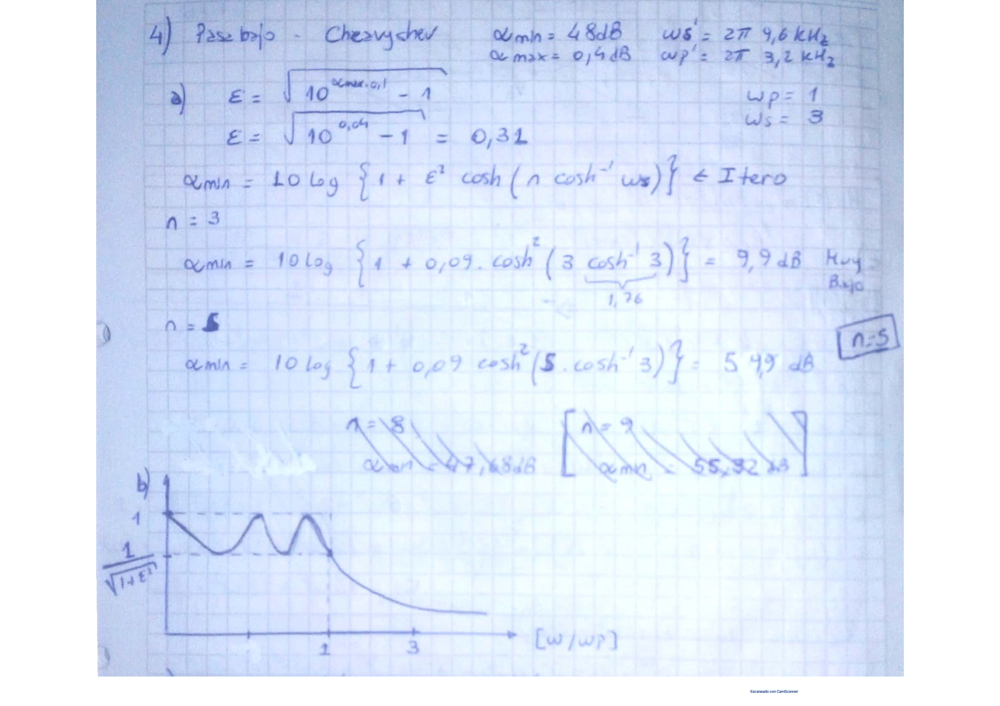

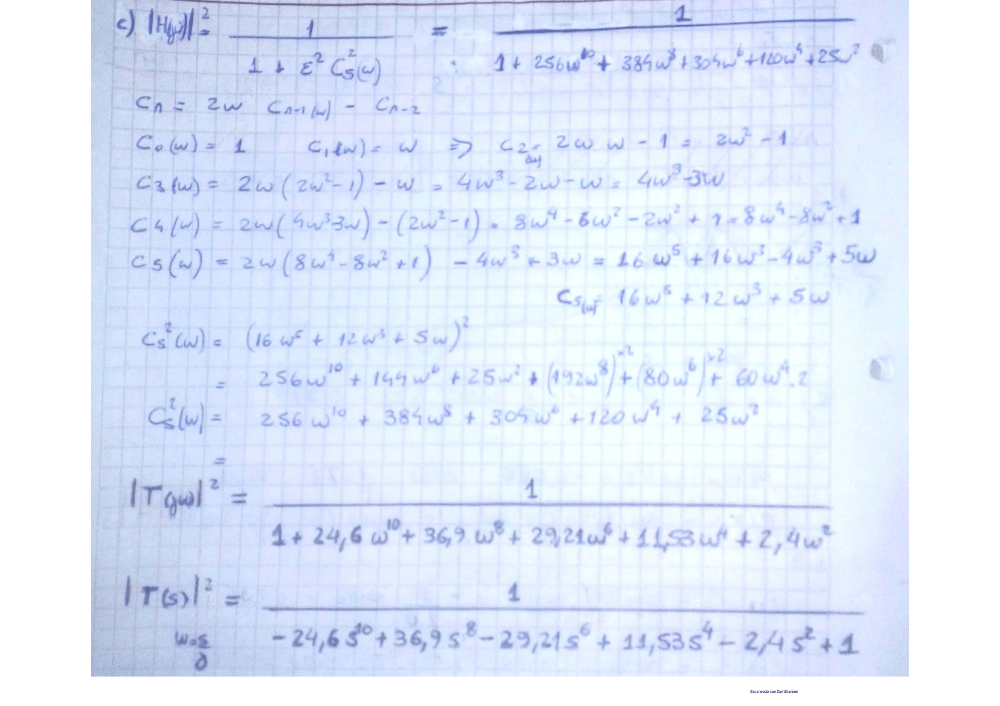

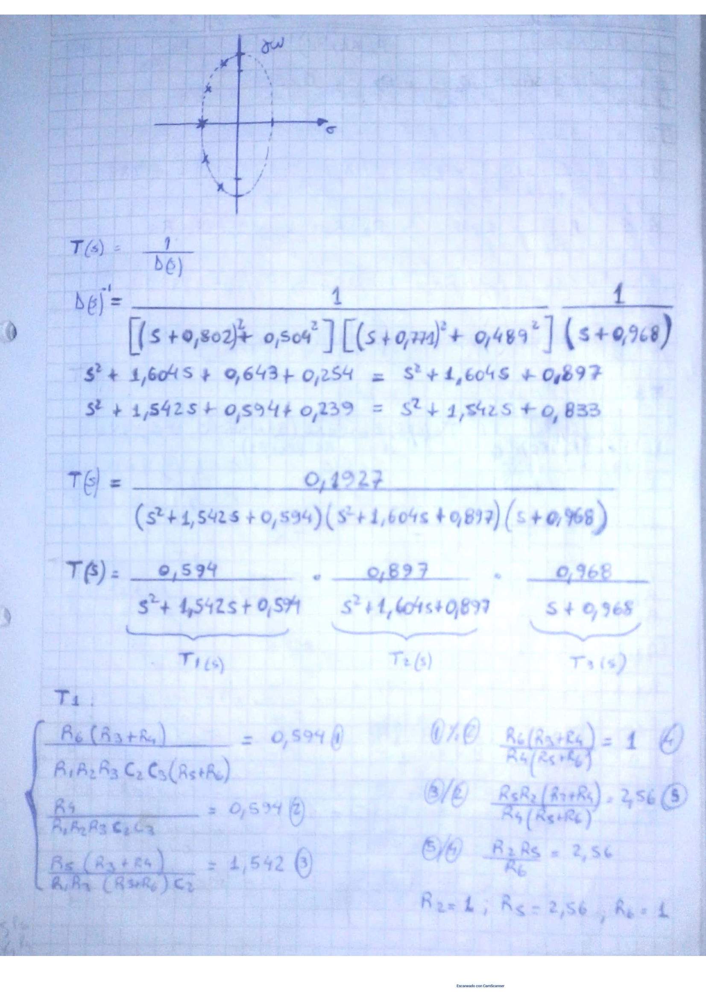

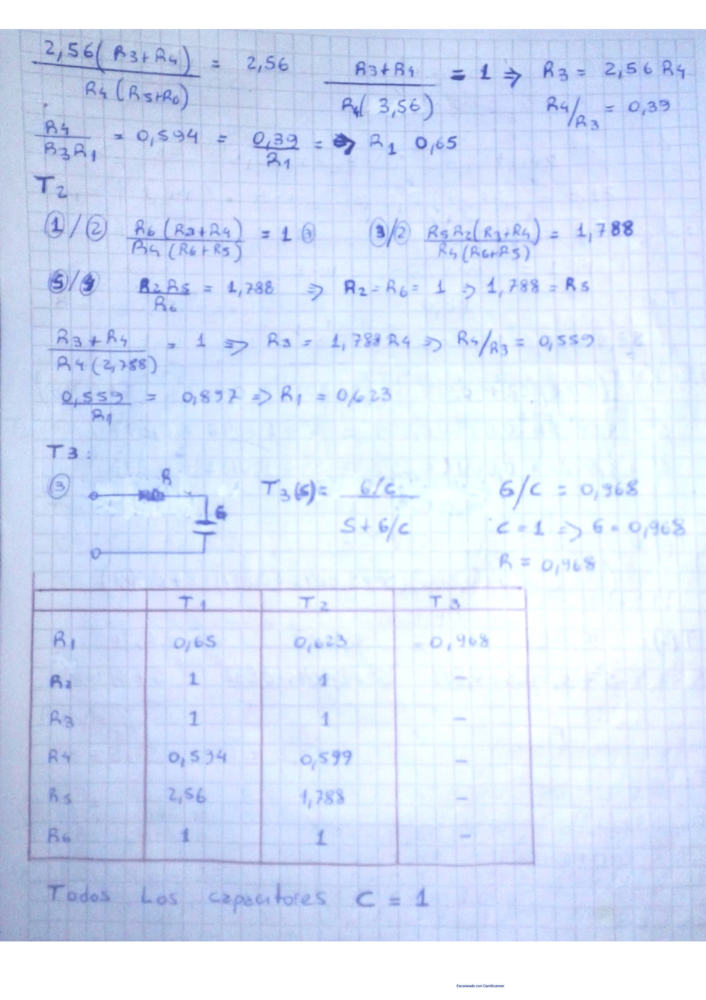

In [7]:
for x in range(4):
    display(Image(filename=f'imagenes/ejercicio_4/Ejercicio 4-{x+1}.png'))

### Ejercicio 5

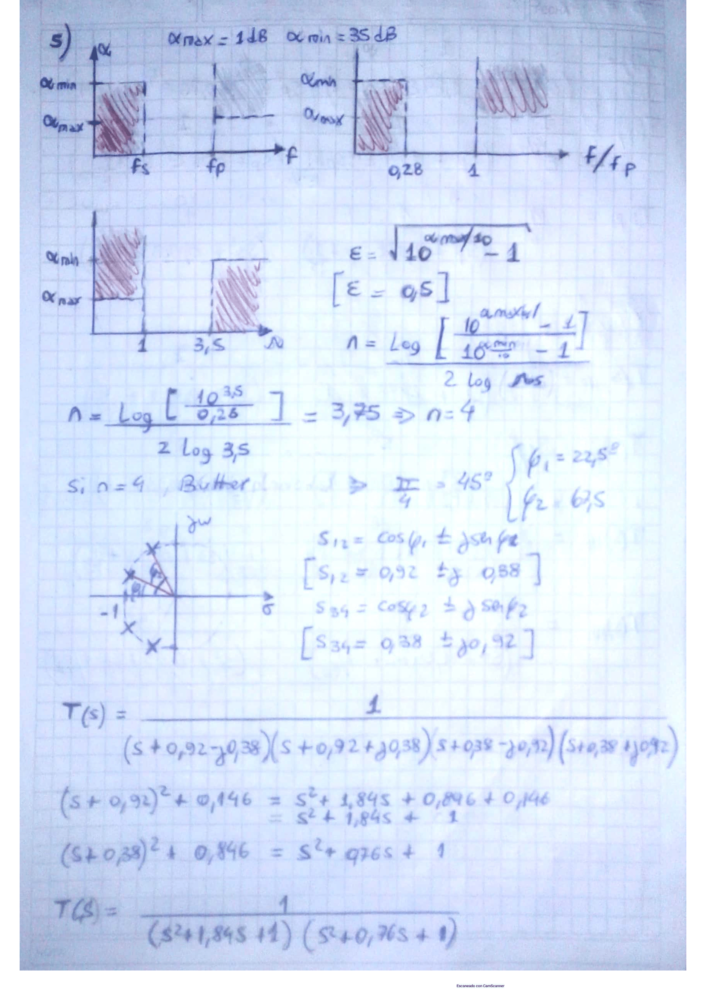

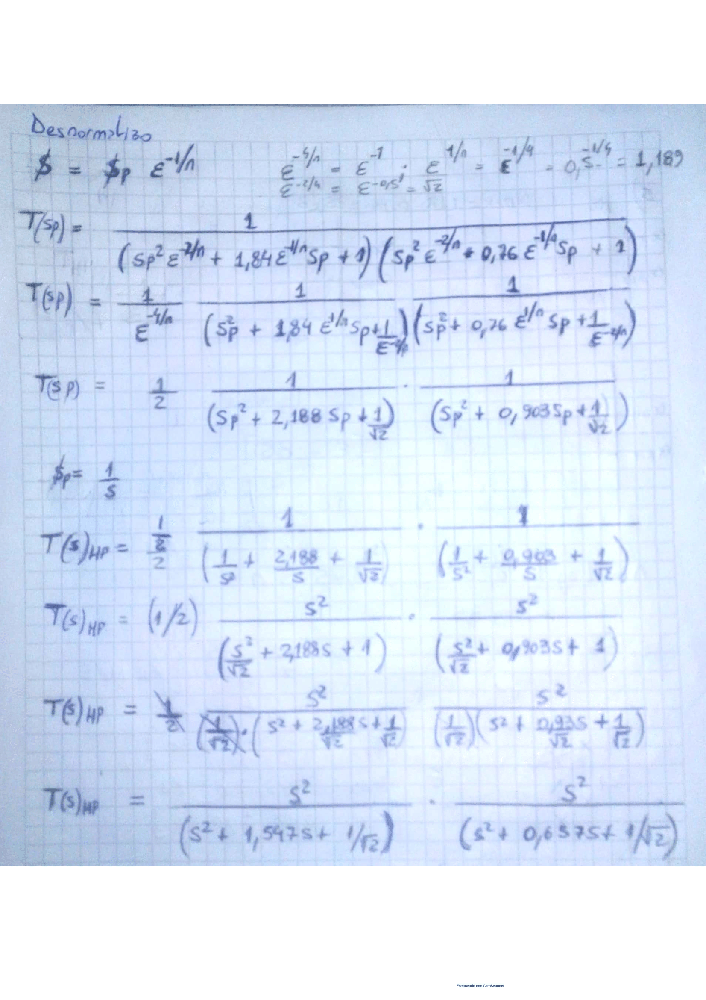

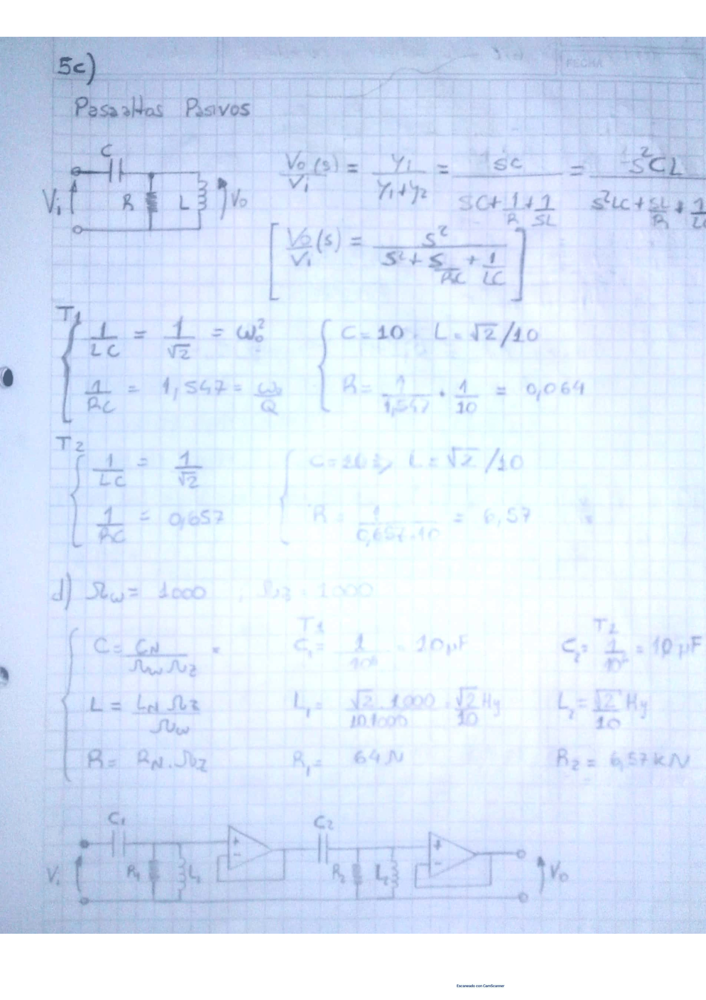

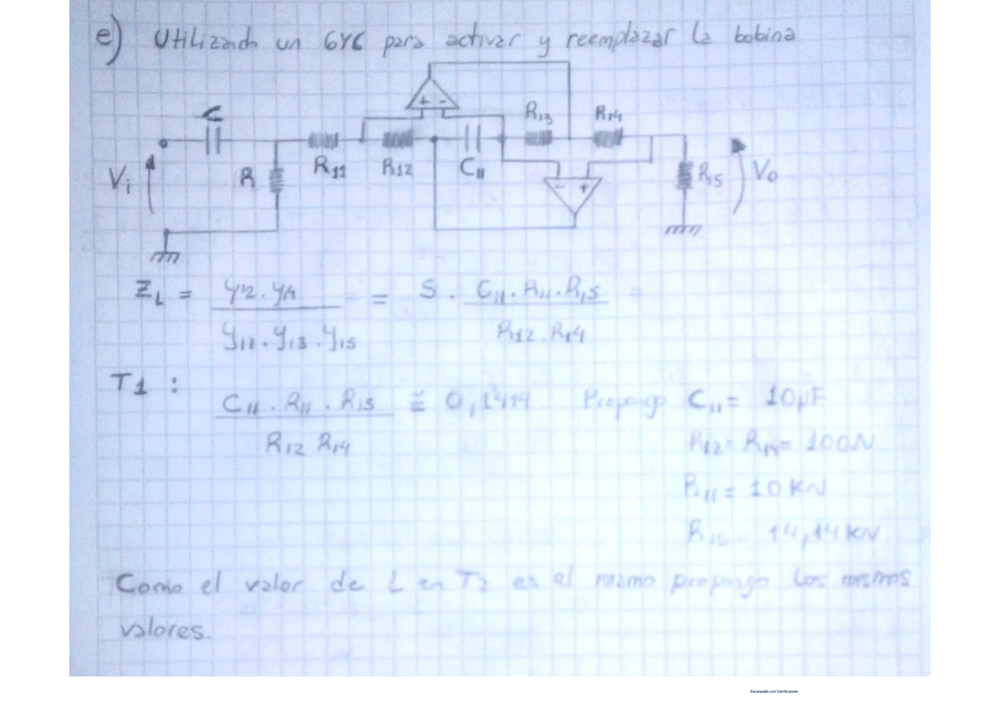

In [8]:
for x in range(4):
    display(Image(filename=f'imagenes/ejercicio 5/Ejercicio 5-{x+1}.png'))

### Ejercicio 6


Realización de un filtro pasa alto:

$$\alpha_{max}=0.4$$
$$\alpha_{min}=48$$
$$f_p = 9600$$
$$f_s = 3200$$

Realizando una transformación de frecuencia en donde $\Omega=1/S$ y normalizando en 9,6KHz:

alfa_max=0.4
alfa_min=48
fp=1
fs=3

Para obtener el filtro de menor orden usamos Chebyshev:

In [9]:
alfa_min=48 # en dB
alfa_max=0.4 # en dB
wp=1
ws=3
epsilon=np.sqrt(10**(alfa_max/10)-1)
N=np.arccosh(np.sqrt((10**(alfa_min/10)-1)/epsilon**2))/np.arccosh(ws)
N=np.ceil(N)
display(Math(f"ε={epsilon}"))
display(Math(f"N={N}"))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Dado que es el mismo orden y epsilon que el ej 4. La ubicación de los polos es la misma y la transferencia también.

In [10]:
denn=[-24.6016, 0, -61.5040,0,-53.816,0,-19.22,0,-2.4025,0,1]
polos=np.roots(denn)
polost=[]
for polo in polos:
    if (polo.real < 0):
        polost.append(polo.round(2))
print(polost)        


[(-0.12+1.02j), (-0.12-1.02j), (-0.31+0.63j), (-0.31-0.63j), (-0.39+0j)]


Recordando teniamos:

Q de la etapa 1: 1.13
Q de la etapa 2: 4.27
Wo de la etapa 1: 0.70
Wo de la etapa 2: 1.02

Si utilizamos un circuito RLC serie saliendo por la tensión en el inductor su transferencia es:

$$ T(s)=\frac{s^2}{s^2+s\frac{R}{L}+\frac{1}{LC}}$$

Como ahora $\omega_0 $ no es 1. Al transformar tenemos que en cada etapa referida a la etapa pasabajo

$$ T(s)=\frac{s^2}{s^2+s\frac{1}{Q\omega_0}+\frac{1}{\omega_0^2}}$$

Comparando:

Si C=1

Para la primer etapa:

$L=\frac{\omega_0^2} =2.02 $

$R=L \frac{1}{\omega_0Q}=0.62$

Para la segunda etapa:

$L=\frac{\omega_0^2} =1.04

$R=L \frac{1}{\omega_0Q}=0.24$

La tercer etapa de primer orden es identica a la utilizada en el ejercicio 4, intercambiando R por C  pero con los mismos valores

El polo está ubicado en: 

$\sigma=-0,39$

Por lo que: 

Si utilizamos un RC y dejamos que C=1:7.53


$R=2,56 $

<img src="imagenes/6norm.png" align="center" width="600" /> 
<img src="imagenes/6normsimu.png" align="center" width="600" /> 

Desnormalizando para resistores de 2.2K$\Omega$ y frec =9,6KHz

Primer etapa:

$R'=R RN=1364\Omega$

$C'=\frac{C}{RN 2\pi 9,6KHz}=7.53nf$

L'=\frac{L RN}{2\pi 9,6KHz}=17.8mH$

Para la segunda:

$R'=R RN=528\Omega$

$C'=\frac{C}{RN 2\pi 9,6KHz}=7.53nf$

L'=\frac{L RN}{2\pi 9,6KHz}=38mH$

Para la etapa de primer orden:

$R'=R \cdot RN=5632\Omega$

$C'=\frac{C}{RN 2\pi 9,6KHz}=7.53nf$

<img src="imagenes/6desnorm.png" align="center" width="600" /> 

<img src="imagenes/6desnormsimu.png" align="center" width="600" /> 

Activando el circuito con OTA para reemplazar los inductores tenemos:


En donde $Leq=\frac{C}{gm_1 gm_2}$

Para la primer etapa:

si usamos el mismo C de 7,54nf

$gm_1=gm_2=650uS$


Para la segunda etapa:

si usamos el mismo C de 7,54nf

$gm_1=gm_2=445.15uS$

<img src="imagenes/6activado.png" align="center" width="600" /> 



### Ejercicio 7

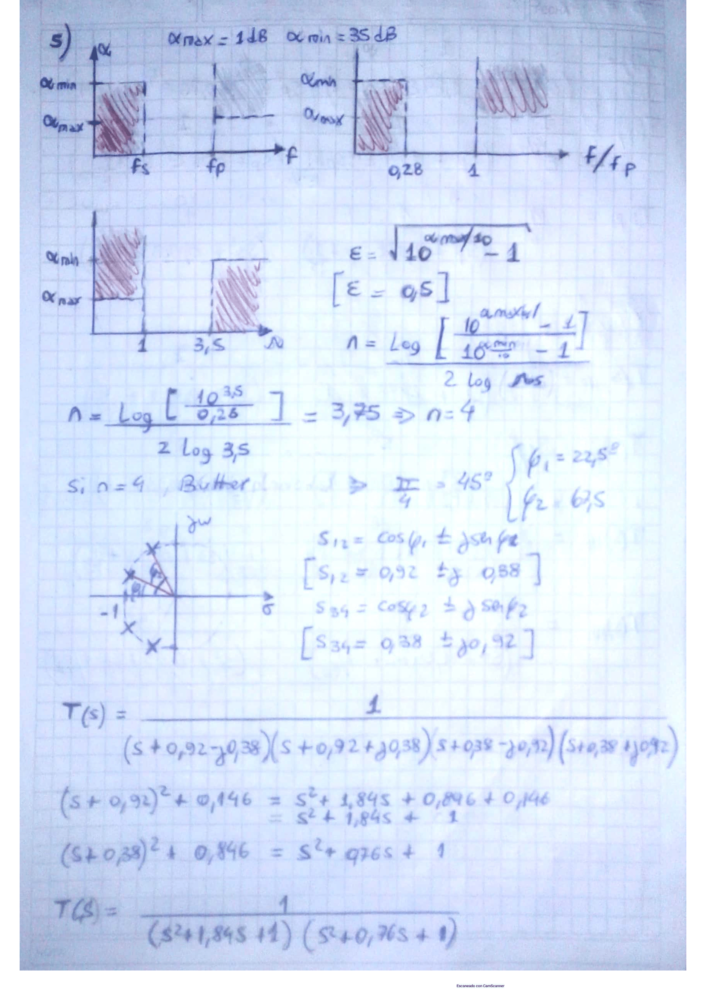

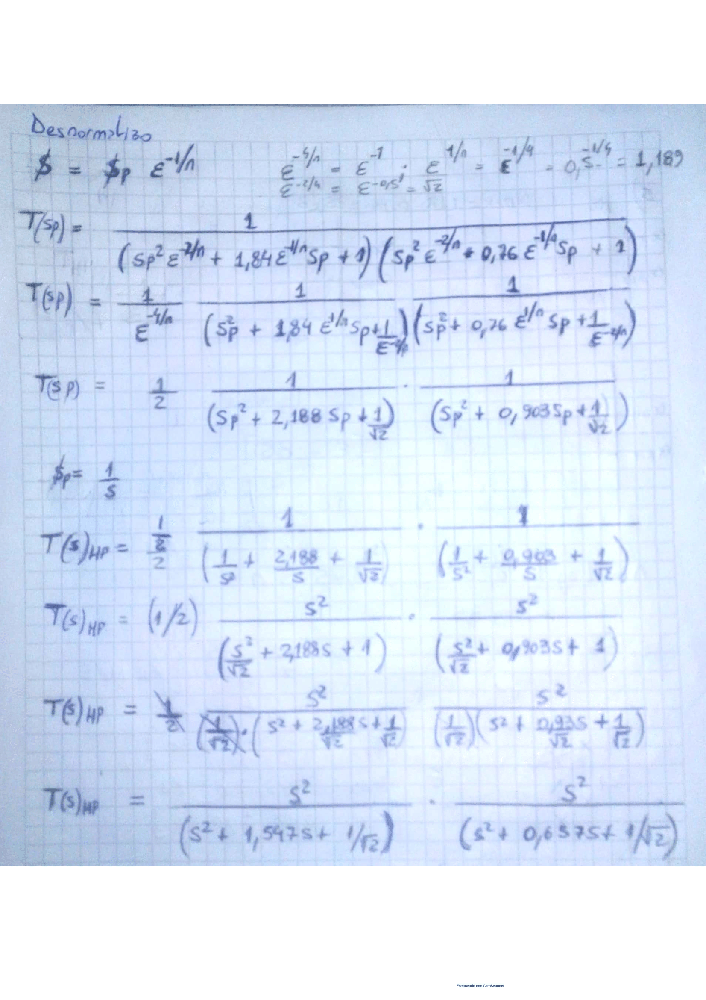

In [11]:
for x in range(2):
    display(Image(filename=f'imagenes/ejercicio 5/Ejercicio 5-{x+1}.png'))

#### Implementación con estructura Multiple-feedback

<img src="imagenes/Multiple-Feedback.png" align="center" width="400" /> 

En donde las expresiones de diseño son:

$$\omega_0^2=\frac{1}{R_4C_5R_3C_2}$$

$$K=-\frac{R_4}{R_1} $$

$$Q=\frac{\sqrt{R_3R_4C_2C_5}}{(R_3+R_4+\frac{R_4R_3}{R1})C_5}$$

Como tenemos que K=1,$R_4=R_1=R_3=1\Omega$

Si reemplazamos $\omega_0^2$ en la expresion de Q tenemos

$$Q=\frac{1}{3\omega_0C_5}$$

Como $\omega_0^2=11,48$ 

Como $\omega_0=3,38$

$$Q=\frac{1}{3,38 (3)C_5}$$

$$Q=\frac{1}{10,14 C_5} $$

$$C_5=\frac{1}{8,11} $$

$$C_5=0,12$$

$C_2=\frac{1}{\omega_0^2 C_5}$

$C_2=\frac{1}{11,35 C_5}=0,73$

Para la segunda etapa:

Como $\omega_0^2=9$ 

Como $\omega_0=3$

$$Q=\frac{1}{9C_5} $$

$$C_5=\frac{1}{9 Q} $$

$$C_5=0,21$$

$C_2=\frac{1}{9 C_5}=0,51$

Valores de los capacitores:

Primer etapa:

$C_2=0,73F$

$C_5=0,12F$

Segunda etapa:

$C_2=0,51F$

$C_5=0,21F$

Vamos a desnormalizar el circuito.

Elevamos el valor de todos los resistores a 1K$\Omega$

y recordamos que nuestra $\omega_{norm}=10k \frac{rad}{seg}$

Capacitores:

$C'=\frac{C}{1K\omega_{norm}} $

<img src="imagenes/ej7cir.png" align="center" width="400" /> 

<img src="imagenes/ej7retardo.png" align="center" width="400" /> 

<img src="imagenes/ej7modulo.png" align="center" width="400" /> 

### Ejercicio 8

Se debe diseñar un filtro pasabanda con las siguientes especificaciones:
* Frecuencia de corte inferior 𝑓 : 1600 KHz 𝑐𝑖
* Frecuencia de corte superior 𝑓 : 2500 KHz 𝑐𝑠
* Ripple máximo en la banda de paso ε: 3dB
* Máxima planicidad en la banda de paso.
* Ganancia máxima en la banda de paso: 10 dB
* Atenuación mínima α de 20 dB a las frecuencias de 1250 KHz y 3200 KHz. 𝑚í𝑛

Se pide:

* a) Obtener la función transferencia normalizada del filtro
* b) Graficar el diagrama de polos y ceros
* c) Graficar la transferencia (módulo y fase) del filtro pedido
* d) Sintetizar el filtro utilizando estructuras Ackerberg-Mossberg (AM).
* e) Simular el filtro obtenido, verificando las especificaciones de diseño


Para comenzar obtenemos la frecuencia central del filtro:

$f_0=\sqrt{f_{cs} \cdot f_{ci}} =\sqrt{1,6MHz \cdot 2,5MHz} = 2 MHz $

Utilizamos este valor para normalizar las frecuencias:

$f_{ci}=\frac{1,6MHz}{2MHz} = 0,8$

$f_{ci}=\frac{2,5MHz}{2MHz} = 1,25$

Buscamos el ancho de banda de nuestro filtro normalizado como:

B=1,25-0,8=0,45

$Q=\frac{f_0}{B}=2,22 $


Resumiendo:

$f_{s1}=0,625 $
$f_{p1}=0,8 $
$f_0=1 $
$f_{p2}=1,25 $
$f_{s2}=1,6 $

$\alpha_{min}=20dB $

$\alpha_{max}=3dB $

Utilizando la transformación de pasa banda a pasa bajo:

$ K(\omega)=Q \cdot \frac{\omega^2-1}{\omega} $

$f_{s1}=-2,16 $
$f_{p1}=-1 $
$f_0=0 $
$f_{p2}=1 $
$f_{s2}=2,16 $


Diseñamos el pasa bajo para $f_p=1$ y $f_s=2,16$


Como por espeficifacion la atenuación en $f_p=3dB$ sabemos que $\epsilon=1$ filtro de Butterworth. Buscamos ahora el orden del filtro



In [12]:
ripple = 3 # dB \alpha_{max} 
attenuation = 20 # dB \alpha_{min} 
ws= 2.16

eps = 1
order =  np.divide(np.log10(np.divide(np.subtract(np.power(10,np.divide(attenuation,10)),1),np.power(eps,2))),(np.multiply(2,np.log10(ws))))
order=np.ceil(order)
display(Math(f"Orden:{order}"))

<IPython.core.display.Math object>

Polos separados:

$\frac{180º}{3}=60º$

$$T(s)=\frac{1}{s^2+s 2cos(60º)+1} \cdot \frac{1}{s+1} $$

$$T(s)=\frac{1}{s^2+s+1} \cdot \frac{1}{s+1} $$

Acomodando todo:

$$ T(s)=\frac{1}{s^3+2s^2+2s+1} $$

Ahora aplicando la transformación inversa para llevarlo al pasabanda:

$$ s=Q\frac{S^2+1}{S} $$


$$ T(S)=\frac{S^2}{Q^2(S^2+1)^2+SQ(S^2+1)+S^2} \cdot \frac{S}{Q(S^2+1)+1} $$

$$ T(S)=\frac{S^2}{Q^2S^4+2Q^2S^2+Q^2+QS^3+QS+S^2} \cdot \frac{S}{(QS^2+Q+1)} $$

$$ T(S)=\frac{Q^2S^2}{S^4+2S^2+1+\frac{S^3}{Q}+\frac{S}{Q}+\frac{S^2}{Q^2}} \cdot \frac{QS}{(S^2+1+\frac{1}{Q})} $$

$$ T(S)=\frac{Q^2S^2}{S^4+\frac{S^3}{Q}+2S^2+\frac{S^2}{Q^2}+\frac{S}{Q}+1} \cdot \frac{QS}
{(S^2+1+\frac{1}{Q})} $$

$$ T(S)=\frac{Q^2S^2}{S^4+\frac{S^3}{Q}+S^2(2+\frac{1}{Q^2})+\frac{S}{Q}+1} \cdot \frac{QS}{(S^2+1+\frac{1}{Q})} $$

$$ T(S)=\frac{Q^2S^2}{S^6+\frac{S^5}{Q}+S^4(2+\frac{1}{Q^2})+\frac{S^3}{Q}+S^2+S^4+\frac{S^3}{Q}+S^2(2+\frac{1}{Q^2})+\frac{S}{Q}+1+\frac{S^4+\frac{S^3}{Q}+S^2(2+\frac{1}{Q^2})+\frac{S}{Q}+1}{Q} }$$







In [13]:
polos=np.roots([1,1,5,3,7,2,2])

for n,polo in enumerate(polos):
    display(Math(f"polo {n+1}:" + sp.latex(polo)))
n

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

5

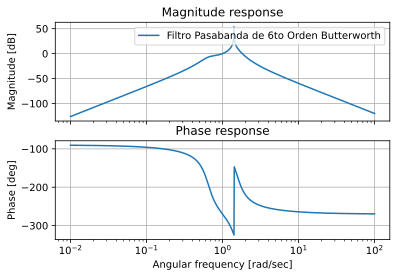

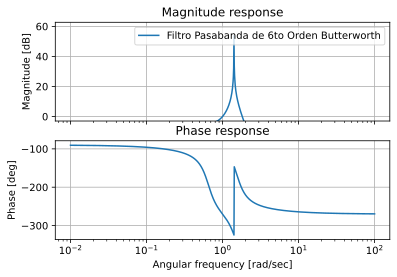

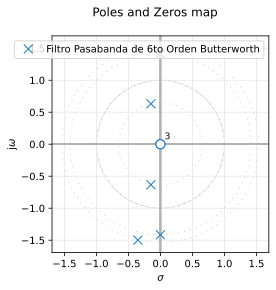

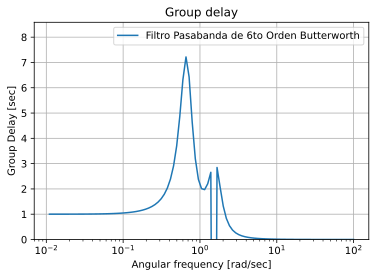

In [14]:
all_sys = []
filter_names = []

num=[1,0,0,0]
den=[1,1,5,3,7,2,2]
all_sys.append(sig.TransferFunction(num,den))
filter_names.append("Filtro Pasabanda de 6to Orden Butterworth")

analyze_sys( all_sys, filter_names )

$$T(s)=4,13 \cdot \frac{0,272s}{s^2+0,272s+1,484} \cdot \frac{0,454s}{s^2+0,454s+1} \cdot \frac{0,184s}{s^2+0,184s+0,675} $$

Vamos a sintetizar el filtro con una estructura Ackerberg-Mosberg de segund oorden y una de primer orden.

Vamos a sintetizar el filtro con tres estructuras Ackerberg-Mosberg.

Estructura a utilizar:

<img src="imagenes/acker.png" align="center" width="700" /> 

Definimos los parametros para cada etapa:

Primera etapa

$\omega_0=1,21$

$Q=4,44$

$\omega_0=1$

$Q=2,2$

$\omega_0=0,82$

$Q=4,44$

Repartimos el K en las tres etapas $\sqrt[3]{4,13}=1,6=K$

<img src="imagenes/Ackernorm.png" align="center" width="700" /> 

<img src="imagenes/simu1.png" align="center" width="700" /> 

Desnormalizamos para 2MHz y R=1K


<img src="imagenes/ackerdesnorm.png" align="center" width="700" /> 

<img src="imagenes/simu2.png" align="center" width="700" /> 

<img src="imagenes/simu3.png" align="center" width="700" />


### Ejercicio 9

Similar al 8 pero con Chebyshev y ripple de 1dB en la banda de paso


In [15]:
alfa_min=20 # en dB
alfa_max=1 # en dB
wp=1
ws=2.16
epsilon=np.sqrt(10**(alfa_max/10)-1)
N=np.arccosh(np.sqrt((10**(alfa_min/10)-1)/epsilon**2))/np.arccosh(ws)
N=np.ceil(N)

display(Math(f"ε={epsilon.round(2)}"))
display(Math(f"N={N}"))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Sabiendo que nuestro filtro es de tercer orden obtenemos los polinomios:
        
$$ C_n(𝜔)=2𝜔 C_{n-1}(𝜔)-C_{n-2}(𝜔)$$

$$ C_0(𝜔)=1 $$
$$ C_1(𝜔)= 𝜔 $$
$$ C_2(𝜔)=2𝜔^2-1 $$
$$ C_3(𝜔)=2𝜔 (2𝜔^2-1)-𝜔 =4𝜔^3-3𝜔 $$

Armando el demonimador:

$Den(j𝜔)^2=1+𝜖^2 \cdot C_3^2(𝜔) $

$Den(j𝜔)^2=1+𝜖^2 \cdot (4𝜔^3−3𝜔)^2$

$𝜔^3=\frac{s^3}{j^3}=\frac{s^3}{-j} $

$𝜔=\frac{s}{j} $

$Den(s)^2=1+𝜖^2 \cdot (\frac{-4s^3}{j}-\frac{3s}{j})^2 $

$Den(s)^2=1+𝜖^2 \cdot \frac{1}{j^2}(-4s^3-3s)^2 $

$Den(s)^2=1-𝜖^2 \cdot (-4s^3-3s)^2 $

$Den(s)^2=1-𝜖^2 \cdot (16s^6+24s^4+9s^2) $

Expandimos todo y obtenemos los polos y nos quedamos con aquellos que tienen parte real negativa:

In [16]:
from sympy import *
from sympy.solvers import solve
import numpy as np
from sympy import init_printing
init_printing() 

epsilon=0.51
s=Symbol('s') 
cn=(-4*s**3-3*s)**2 
den=1-(epsilon**2)*expand(cn)
den=poly(den)
den=tuple(den.all_coeffs())
polos=np.roots(den).round(2)
polost=[]
for polo in polos:
    if (polo.real < 0):
        if(polo.imag==0):
            polost.append(polo.real)
        else:polost.append(polo)


for n,polo in enumerate(polost):
    display(Math(f"Polo{n}:{polo}"))


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Armamos el nominador sabiendo que la sección de segundo orden cuyo polo es $\alpha±j\beta$

$$T_{sos}(s)=\frac{\alpha^2+\beta^2}{s^2-2\alpha s+\alpha^2+\beta^2}$$

In [17]:
den_2sos=[]
polos_simply=[]
polos_simply.append(polost[0])

s = sp.symbols("s")
for i in range(1,len(polost)):
    if((polost[i].real!=polost[i-1].real) or (polost[i].imag!=-polost[i-1].imag)):
        polos_simply.append(polost[i])
for polo in polos_simply:
    if(polo.imag!=0):
        den_2sos.append([1, -2*(polo.real).round(2), (polo.real**2+polo.imag**2).round(2)])
    else:
        den_2sos.append([1, -polo.real])
print(den_2sos)

dem = s ** 2 * den_2sos[0][0] + s**1 * den_2sos[0][1] + den_2sos[0][2]
dem2 = s * den_2sos[1][0] + den_2sos[1][1]

display(Math("H(s)="+sp.latex(1/dem) + "\\cdot" + sp.latex(den_2sos[1][1]/dem2)))

[[1, 0.5, 1.0], [1, 0.49]]


<IPython.core.display.Math object>

$$T(s)=\frac{1}{s^2+0,5s+1} \cdot \frac{0.5}{s+0.5} $$

Para pasarlo a pasabanda aplicamos el nucleo de transformación en donde:

$$s=Q\frac{S^2+1}{S}$$

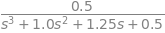

In [29]:
#T(s)=\frac{1,2}{s^2+0,68s+1,2} \cdot \frac{0,67}{s+0,67} $$
Tpb=(1)/(s**2+0.5*s+1) * ((0.5)/(s+0.5))
Tpb=expand(Tpb)
Tpb

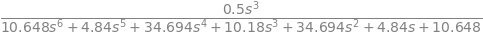

In [19]:
Q=2.2
monico=true
# si no me interesa monico
if monico==false:
    z=((s**2+1)/s)  #agrego el Q a mano en cada expresión para que me quede mónico
    Tpband=(1/Q**2)/(z**2+0.5*z/Q+1/Q**2) * ((0.5/Q)/(z+0.5/Q))
else:
    z=(Q*(s**2+1)/s)
    Tpband=(1)/(z**2+0.5*z+1) * ((0.5)/(z+0.5))
    
Tpband=cancel(Tpband)
Tpband

In [20]:
polos=np.roots([10.648,4.84,34.694,10.18,34.694,4.84,10.648])

for n, polo in enumerate(polos):
    display(Math(f"polo{n+1}:{polo}"))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

In [21]:
den_2sos=[]
polos_simply=[]
polos_simply.append(polos[0])
for i in range(1,len(polos)):
    if((polos[i].real!=polos[i-1].real) or (polos[i].imag!=-polos[i-1].imag)):
        polos_simply.append(polos[i])
for polo in polos_simply:
    if(polo.imag!=0):
        den_2sos.append([1, -2*(polo.real).round(3), (polo.real**2+polo.imag**2).round(3)])
    else:
        den_2sos.append([1, -polo.real])
print(den_2sos)

[[1, 0.138, 1.549], [1, 0.228, 1.0], [1, 0.09, 0.646]]


In [22]:
w01=np.sqrt(den_2sos[0][2])
w02=np.sqrt(den_2sos[2][2])
w03=np.sqrt(den_2sos[1][2])
Q1=w01/den_2sos[0][1]
Q2=w02/den_2sos[2][1]
Q3=w03/den_2sos[1][1]
display(Math((f"w_1:{w01.round(3)}" + "y" + f"Q_1:{Q1.round(3)}")))
display(Math((f"w_2:{w02.round(3)}")))
display(Math((f"Q_2:{Q2.round(3)}")))
display(Math((f"w_3:{w03.round(3)}")))
display(Math((f"Q_3:{Q3.round(3)}")))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

$$T(s)= \frac{0.138S}{S^2+0.138S+1.549} \cdot \frac{0.228S}{S^2+0.228S+1} \cdot \frac{0.09S}{S^2+0.09S+0.646} $$

De la relacíón de ganancia de la transferencia completa a las 3 SOS 0.138 x 0.228 x 0.09=0,002831


$\frac{0.5}{0,002831 x 10,648 }=16,28$ Veces falta amplificar


$$T(s)=16,28 \cdot \frac{0.138S}{S^2+0.138S+1.549} \cdot \frac{0.228S}{S^2+0.228S+1} \cdot \frac{0.09S}{S^2+0.09S+0.646} $$

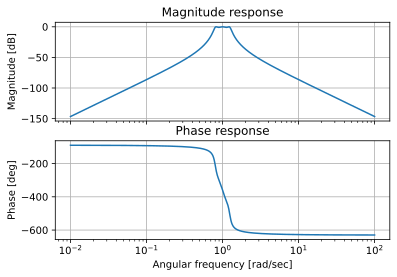

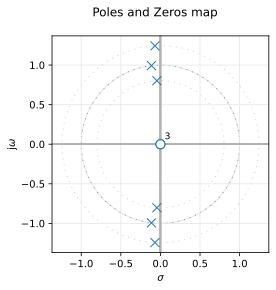

In [23]:
num=[0.5,0,0,0]
den=[10.648,4.84,34.694,10.18,34.694,4.84,10.648]

all_sys=(sig.TransferFunction(num,den))


fig_id, axes_hdl = bodePlot(all_sys, 1, ())
analog_fig_id, analog_axes_hdl = pzmap(all_sys, filter_names, 3, ())

Implementacion con estructura Ackerberg-Mossber

* K=$\sqrt[3]{16,28}=2,53$
* w01: 1.245
* Q1: 9.019
* w02: 0.804
* Q2: 8.93
* w03: 1.0
* Q3: 4.386

<img src="imagenes/ej10norm.png" align="center" width="700" /> 

<img src="imagenes/ej10simunorm.png" align="center" width="700" /> 

Llevando todo a 2MHz y 1K$\Omega$

<img src="imagenes/ej10desnorm.png" align="center" width="700" /> 

<img src="imagenes/ej10simudesnorm.png" align="center" width="700" /> 


## Ejercicio 10
Un tono de 45 KHz y 200 mV de amplitud es distorsionado por un tono de 12 KHz y 2 V de amplitud. Diseñar un filtro pasa altos que atenúe la señal interferente, de tal forma que el remanente no sea mayor que el 2% de los 200 mV.

La ganancia en alta frecuencia deberá ser de 0 dB y la máxima atenuación en la banda de paso menor a 1 dB. Emplear la aproximación que necesite menor número de etapas.

Sintetizar el filtro utilizando la siguiente estructura. Considere a A1 y a A2 como dos OTAs ideales
cuyos parámetros son $gm_1$ y $gm_2$.

Frecuencia de normalización para el Pasa Alto= 45KHz

Debe quedar menos que el 2% de 200mv=4mv 

Atenuación=$\frac{2}{4mv}$=500 Veces=54dB

Plantilla del pasa alto:

* $\alpha_{max}=1dB$
* $\alpha_{min}=54dB$
* $f_p=1$ 
* $f_s=0,26$ 

Pasando al pasa bajo

* $\alpha_{max}=1dB$
* $\alpha_{min}=54dB$
* $f_p=1$ 
* $f_s=3,84$ 

Veamos el oredn del filtro:

Comparando Maxima Planicidad y Cheby

In [24]:
ripple = 1 # dB \alpha_{max} 
attenuation = 54 # dB \alpha_{min} 
ws= 3.84

eps = np.sqrt(np.subtract(np.power(10,np.divide(ripple,10)),1)).round(2)
order =  np.divide(np.log10(np.divide(np.subtract(np.power(10,np.divide(attenuation,10)),1),np.power(eps,2))),(np.multiply(2,np.log10(ws))))
order=np.ceil(order)
print("Epsilon:",eps)
print("Orden:",order)

Epsilon: 0.51
Orden: 6.0


In [25]:
epsilon=np.sqrt(10**(ripple/10)-1)
N=np.arccosh(np.sqrt((10**(attenuation/10)-1)/epsilon**2))/np.arccosh(ws)
N=np.ceil(N)
print("Episilon:",epsilon.round(2))
print("Orden:",N)

Episilon: 0.51
Orden: 4.0


Utilizamos Cheby dado que pide realizar con la aproximación qu erequiera la menor cantidad de etapas

$$ C_n(\omega)=2\omega C_{n-1}(\omega)-C_{n-2}(\omega)$$

$$ C_0(\omega)=1 $$
$$ C_1(\omega)= \omega $$
$$ C_2(\omega)=2\omega^2-1 $$
$$ C_3(\omega)=2\omega (2\omega^2-1)-\omega =4\omega^3-3\omega $$
$$ C_4(\omega)= 2\omega (4\omega^3-3\omega )-(2\omega^2-1)=8\omega^4-8\omega^2+1$$

Armando el demonimador:

$Den(j\omega)^2=1+\epsilon^2 \cdot C_4^2(\omega) $

$Den(j\omega)^2=1+\epsilon^2 \cdot (8\omega^4-8\omega^2+1)^2$

$\frac{s}{j}=\omega $

$\omega^4=\frac{s^4}{j^4}=\frac{s^4}{j^2 j^2}=s^4 $

$\omega^2=\frac{s^2}{j^2}=-s^2 $

$Den(s)^2=1+\epsilon^2 \cdot {(8s^4+8s^2+1)}^2  $

$$ (a+b+c)^2=a^2+b^2+c^2+2ab+2ac+2bc $$

$Den(s)^2=1+\epsilon^2 \cdot (64s^8+64s^4+1+128s^6+16s^4+16s^2) $

$Den(s)^2=1+\epsilon^2 \cdot (64s^8+128s^6+80s^4+16s^2+1) $

$\epsilon=0.51$

$Den(s)^2=1+16,64s^8+33,29s^6+20,808s^4+4,16s^2+0,26 $

$Den(s)^2=16,64s^8+33,29s^6+20,808s^4+4,16s^2+1,26 $

In [26]:
denn=[16.64,0,33.29,0,20.808,0,4.16,0,1.26]
polos=np.roots(denn)
polost=[]
for polo in polos:
    if (polo.real < 0):
        polost.append(polo.round(2))
print(polost) 

[(-0.14+0.98j), (-0.14-0.98j), (-0.34+0.41j), (-0.34-0.41j)]


Chequeamos con La función de SCIPY

In [27]:
from scipy import signal
N=4
alfa_max=1
z, p,k = signal.cheby1(N, alfa_max, 1, 'low', analog=True,output='zpk')
p=p.round(2)
print(p)

[-0.14+0.98j -0.34+0.41j -0.34-0.41j -0.14-0.98j]


$$ T(s)=\frac{1}{s^2+2\cdot0,14s+(0,14^2+0,98^2)} \cdot \frac{1}{s^2+2\cdot0,34s+(0,34^2+0,41^2)}$$

$$ T(s)=\frac{1}{s^2+0,28s+0,98} \cdot \frac{1}{s^2+0,68s+0,28}$$



Transformamos cada celda a pasa alto:

$$ T(s)=\frac{1,02\cdot s^2}{s^2+0,28s+1,02} \cdot \frac{3,57 \cdot s^2}{s^2+2,42s+3,57} $$


Primer etapa:

$\omega_o=0,99$

Q=3,53

Segunda etapa:

$\omega_o=1,89$

Q=0,78


### Implementación

Estructura a utilizar:

<img src="imagenes/ej10cir.png" align="center" width="400" /> 


$$(V_i-V_o)SC_2=(V_o-V_x)gm_2 $$

$$V_x=-V_o gm_1  \frac{1}{SC_1} $$

$$ SC_2V_i=V_o(gm_2+\frac{gm_1}{SC_1}+SC_2 $$

$$ \frac{V_i}{V_o}= \frac{SC_1gm_2+gm_1+S^2C_2C_1}{S^2C_2C_1}$$

$$ \frac{V_o}{V_i}= \frac{S^2C_2C_1}{SC_1gm_2+gm_1+S^2C_2C_1}$$

$$ \frac{V_o}{V_i}= \frac{S^2}{S^2+S\frac{gm_2}{C_2}+\frac{gm_1}{C_1C_2}}$$

de donde vemos que:

$$\omega_0 = sqrt{\frac{gm_1}{C_1C_2}}$$

$$Q=\sqrt{frac{gm_1}{gm_2C_1}} $$

Si $C_1=1 y C_2=1$

$$\omega_0 = sqrt{gm_1}$$

$$Q=\sqrt{frac{gm_1}{gm_2}} $$

Primer etapa:

$gm_1=1$

$gm_2=0,08$

Segunda etapa:

$\omega_o=1,89$

Q=0,78

$gm_1=3,57$

$gm_2=5,86$

A la salida colocamos un atenuador para obtener los 0dB pedidos, aenuando 3,64 veces

R2=2,64
R1=1

Desnormalizamos el valor de los capacitores con la norma de 45KHz y utilizamos un valor de impedancia para diviid rl as trasconductancias de los OTA entonces:

$C=\frac{1}{2\pi45KHz 1K}=3,53nf $

Si no quisieran cargar al siguiente circuito colocar un buffer adaptador


<img src="imagenes/ej10cirfinal.png" align="center" width="700" /> 

